Importing All the important libraries first for data cleaning and manipulation

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

Importing the directories and files on which we are doing the analysis

In [2]:
os.listdir(r'C:\Users\saysa\Desktop\Py_DS_ML_Bootcamp-master\UberProject\Uber\Datasets')

['other-American_B01362.csv',
 'other-Carmel_B00256.csv',
 'other-Dial7_B00887.csv',
 'other-Diplo_B01196.csv',
 'other-Federal_02216.csv',
 'other-FHV-services_jan-aug-2015.csv',
 'other-Firstclass_B01536.csv',
 'other-Highclass_B01717.csv',
 'other-Lyft_B02510.csv',
 'other-Prestige_B01338.csv',
 'other-Skyline_B00111.csv',
 'Uber-Jan-Feb-FOIL.csv',
 'uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-janjune-15_sample.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [3]:
uber = pd.read_csv(r'C:\Users\saysa\Desktop\Py_DS_ML_Bootcamp-master\UberProject\Uber\Datasets\uber-raw-data-janjune-15.csv')

#### Data Wrangling

In [4]:
#Step 1 - Trying to know more about the data and see how we can make necessary transformation for analysis
#Step 2 - To remove any duplicates and change into appropriate data dypes 
#Step 3 - Add new Columns if required to make analysis.

#### STEP 1 - Trying to know more about the data and see how we can make necessary transformation for analysis

In [5]:
uber.shape

(14270479, 4)

In [6]:
uber.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14270479 entries, 0 to 14270478
Data columns (total 4 columns):
 #   Column                Dtype 
---  ------                ----- 
 0   Dispatching_base_num  object
 1   Pickup_date           object
 2   Affiliated_base_num   object
 3   locationID            int64 
dtypes: int64(1), object(3)
memory usage: 435.5+ MB


In [7]:
uber.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


#### STEP 2 - To remove any duplicates and change into appropriate data dypes 

In [8]:
uber.duplicated().sum()

np.int64(898225)

In [9]:
uber.drop_duplicates(inplace=True)

In [10]:
uber.duplicated().sum()

np.int64(0)

#### Step 3 - Add new Columns if required to make analysis.

In [11]:
uber['Pickup_date']=pd.to_datetime(uber['Pickup_date'])

In [12]:
uber.info()

<class 'pandas.core.frame.DataFrame'>
Index: 13372254 entries, 0 to 14270478
Data columns (total 4 columns):
 #   Column                Dtype         
---  ------                -----         
 0   Dispatching_base_num  object        
 1   Pickup_date           datetime64[ns]
 2   Affiliated_base_num   object        
 3   locationID            int64         
dtypes: datetime64[ns](1), int64(1), object(2)
memory usage: 510.1+ MB


In [13]:
uber['Month'] = uber['Pickup_date'].dt.month
uber['Monthname'] = uber['Pickup_date'].dt.strftime('%b')
uber['Hours'] = uber['Pickup_date'].dt.hour
uber['Dayname'] = uber['Pickup_date'].dt.day_name()
uber['Daynumber']=uber ['Pickup_date'].dt.day

In [14]:
uber.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,Month,Monthname,Hours,Dayname,Daynumber
0,B02617,2015-05-17 09:47:00,B02617,141,5,May,9,Sunday,17
1,B02617,2015-05-17 09:47:00,B02617,65,5,May,9,Sunday,17
2,B02617,2015-05-17 09:47:00,B02617,100,5,May,9,Sunday,17
3,B02617,2015-05-17 09:47:00,B02774,80,5,May,9,Sunday,17
4,B02617,2015-05-17 09:47:00,B02617,90,5,May,9,Sunday,17


In [15]:
order_day = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']
order_month = ['Jan','Feb','Mar','Apr','May','Jun']

uber['Dayname'] =  pd.Categorical(uber['Dayname'],categories=order_day,ordered =True)
uber['Monthname'] =  pd.Categorical(uber['Monthname'],categories=order_month,ordered =True)

C:\Users\saysa\AppData\Local\Temp\ipykernel_20208\2731368654.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='Monthname',data=uber,palette= 'Greys')


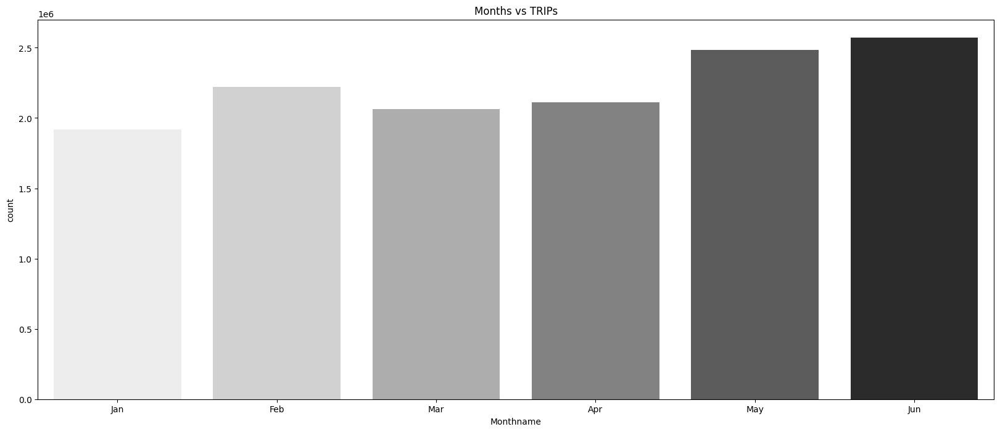

In [16]:
plt.figure(figsize=(20,8))

sns.countplot(x='Monthname',data=uber,palette= 'Greys')
plt.title('Months vs TRIPs')
plt.show()

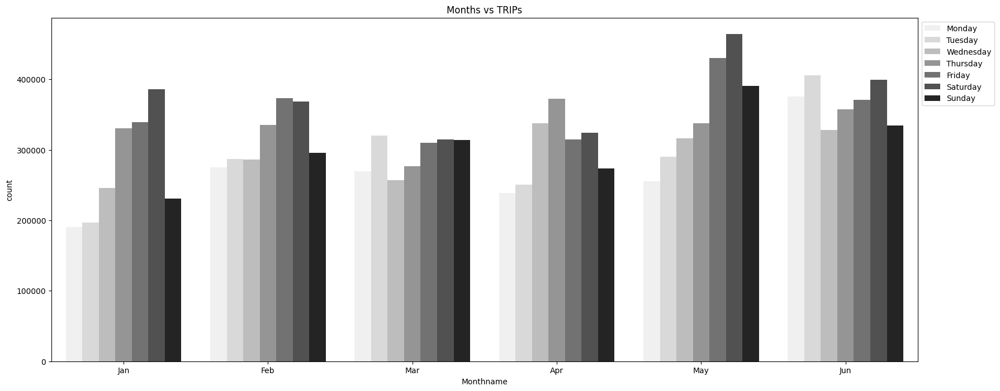

In [17]:
plt.figure(figsize=(20,8))

sns.countplot(x='Monthname',data=uber,hue='Dayname',palette= 'Greys')
plt.title('Months vs TRIPs')
plt.legend(bbox_to_anchor=(1,1),loc='upper left')
plt.show()

C:\Users\saysa\AppData\Local\Temp\ipykernel_20208\1574678910.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='Hours',data=uber,palette='Grays')


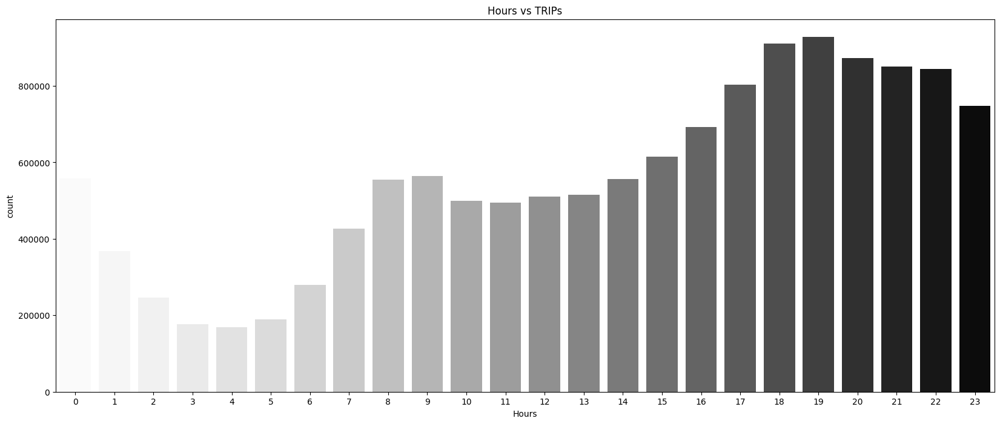

In [18]:
plt.figure(figsize=(20,8))

sns.countplot(x='Hours',data=uber,palette='Grays')
plt.title('Hours vs TRIPs')
plt.show()

C:\Users\saysa\AppData\Local\Temp\ipykernel_20208\3895863553.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='Dayname',data=uber, palette='Grays')


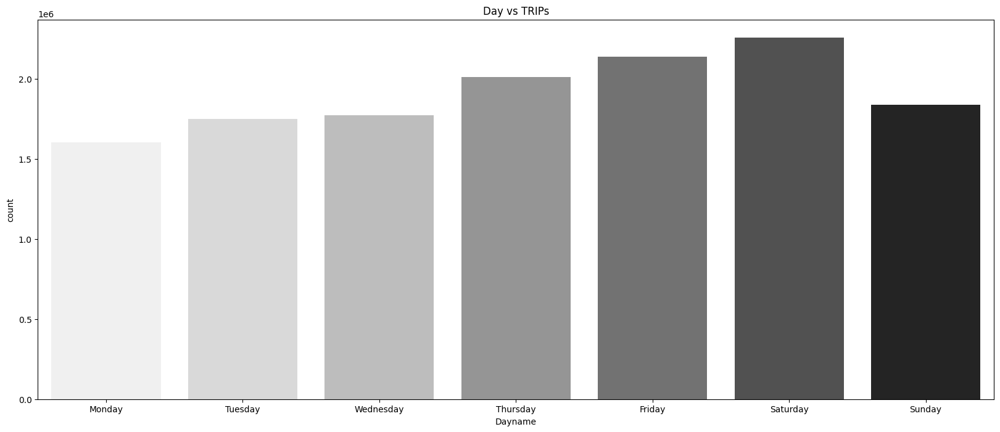

In [19]:
plt.figure(figsize=(20,8))

sns.countplot(x='Dayname',data=uber, palette='Grays')
plt.title('Day vs TRIPs')
plt.show()

In [20]:
var1= uber[uber['Dispatching_base_num'] != uber['Affiliated_base_num']].shape[0]
var2= uber[uber['Dispatching_base_num'] == uber['Affiliated_base_num']].shape[0]

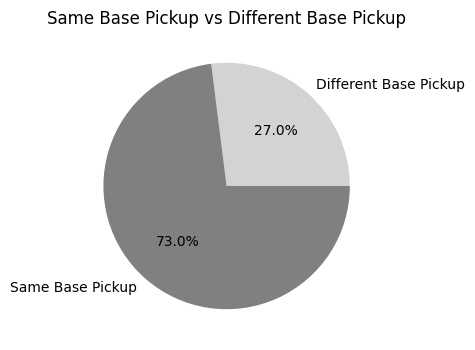

In [21]:
plt.figure(figsize=(4,4))

plt.pie([var1,var2],labels=['Different Base Pickup','Same Base Pickup'],autopct='%1.1f%%',colors=['lightgray','gray'])
plt.title('Same Base Pickup vs Different Base Pickup')
plt.show()

C:\Users\saysa\AppData\Local\Temp\ipykernel_20208\1299006499.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='Dispatching_base_num',data=uber, palette='Grays')


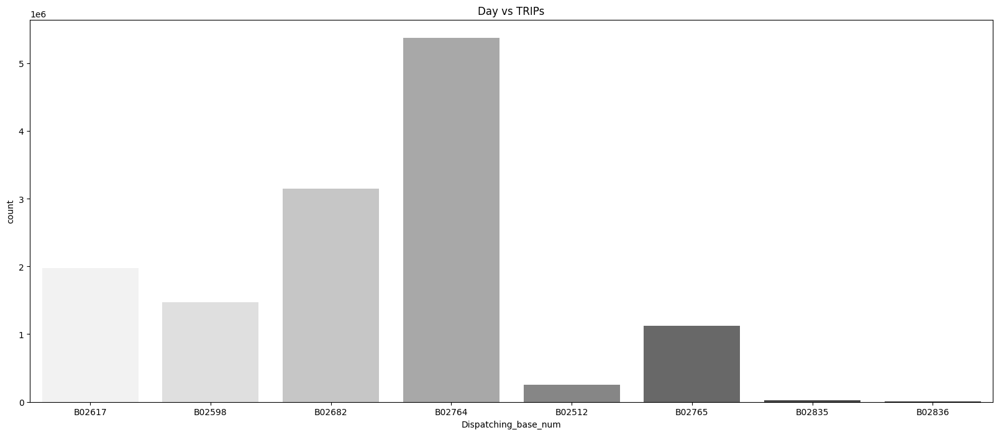

In [22]:
plt.figure(figsize=(20,8))

sns.countplot(x='Dispatching_base_num',data=uber, palette='Grays')
plt.title('Day vs TRIPs')
plt.show()

In [23]:
heatmap = pd.crosstab(uber['Dayname'],uber['Monthname'])

In [24]:
heatmap

Monthname,Jan,Feb,Mar,Apr,May,Jun
Dayname,,,,,,
Monday,190606,274948,269931,238429,255501,375312
Tuesday,196574,287260,320634,250632,290004,405500
Wednesday,245650,286387,256767,338015,316045,328141
Thursday,330319,335603,277026,372522,337607,357782
Friday,339285,373550,309631,315002,430134,371225
Saturday,386049,368311,314785,324545,464298,399377
Sunday,230487,296130,313865,273560,390391,334434


<Axes: xlabel='Monthname', ylabel='Dayname'>

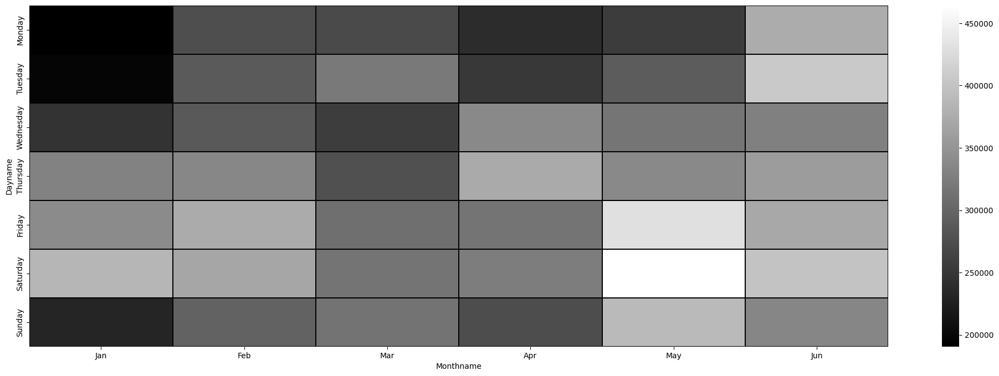

In [25]:
plt.figure(figsize=(25,8))
sns.heatmap(heatmap,cmap = 'gray',linewidths=0.3,linecolor='black')

In [26]:
heatmap1 = pd.crosstab(uber['Dayname'],uber['Hours'])

<Axes: xlabel='Hours', ylabel='Dayname'>

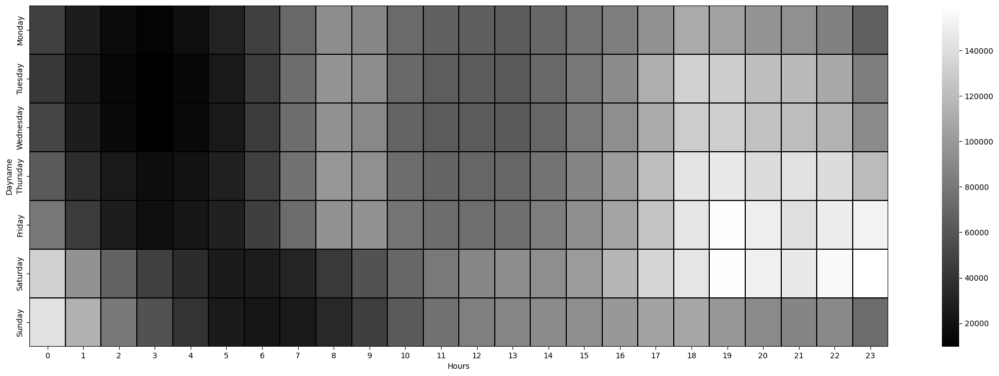

In [27]:
plt.figure(figsize=(25,8))
sns.heatmap(heatmap1,cmap = 'gray',linewidths=0.3,linecolor='black')

In [28]:
heatmap2 = pd.crosstab(uber['Daynumber'],uber['Hours'])

<Axes: xlabel='Hours', ylabel='Daynumber'>

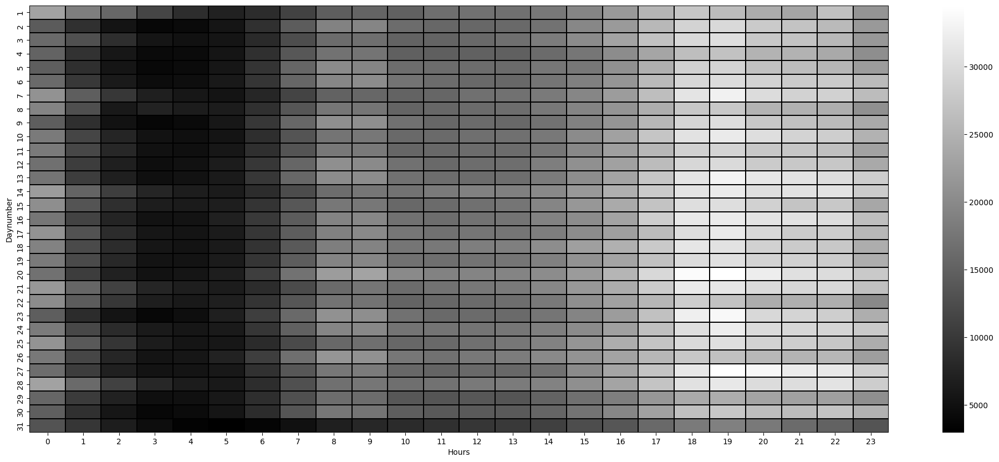

In [29]:
plt.figure(figsize=(25,10))
sns.heatmap(heatmap2,cmap = 'gray',linewidths=0.3,linecolor='black')

Since the LocationID has more than 200 unique values , I decided to take the top 60 by size and relate that with the Base numbers of uber 

In [30]:
base= uber['locationID'].value_counts().nlargest(60).index
basedf = uber[uber['locationID'].isin(base)]
basedf

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,Month,Monthname,Hours,Dayname,Daynumber
0,B02617,2015-05-17 09:47:00,B02617,141,5,May,9,Sunday,17
2,B02617,2015-05-17 09:47:00,B02617,100,5,May,9,Sunday,17
3,B02617,2015-05-17 09:47:00,B02774,80,5,May,9,Sunday,17
4,B02617,2015-05-17 09:47:00,B02617,90,5,May,9,Sunday,17
6,B02617,2015-05-17 09:47:00,B02617,7,5,May,9,Sunday,17
...,...,...,...,...,...,...,...,...,...
14270473,B02765,2015-05-08 15:43:00,B02711,25,5,May,15,Friday,8
14270474,B02765,2015-05-08 15:43:00,B02765,186,5,May,15,Friday,8
14270475,B02765,2015-05-08 15:43:00,B02765,263,5,May,15,Friday,8
14270476,B02765,2015-05-08 15:43:00,B02765,90,5,May,15,Friday,8


In [31]:
heatmap3 = pd.crosstab(uber['Dispatching_base_num'],basedf['locationID'])
heatmap3

locationID,4,7,13,17,25,33,36,37,48,49,...,236,237,238,239,246,249,255,256,262,263
Dispatching_base_num,,,,,,,,,,,,,,,,,,,,,
B02512,1227,1124,2720,856,835,1012,734,959,4649,942,...,5356,7423,2589,3454,5619,5949,2455,1626,1738,2230
B02598,9338,7984,14845,7362,6974,8162,6479,9138,25729,8423,...,24927,31504,13828,19309,29286,35630,22360,14333,10826,13093
B02617,12662,10774,20545,11076,9546,11189,9731,13904,34385,13040,...,33762,40826,19057,26819,40040,45587,28910,18836,16033,19465
B02682,21775,23849,29613,19593,16721,18280,19350,26294,55704,20856,...,48004,58292,31422,41822,57746,65484,47564,32898,24509,29957
B02764,34175,36511,55374,31688,26922,29948,31838,42766,97123,35690,...,84898,102321,50260,69136,101782,116396,82684,55051,42485,52636
B02765,6919,7324,10321,7144,6169,6805,6473,8599,20450,7869,...,17190,21419,10606,14142,21240,23685,16686,11049,8132,10096
B02835,156,239,220,204,139,139,139,226,514,134,...,340,440,241,327,530,483,393,298,183,230
B02836,13,30,15,33,15,13,58,53,35,23,...,25,29,11,15,25,25,53,28,4,13


<Axes: xlabel='locationID', ylabel='Dispatching_base_num'>

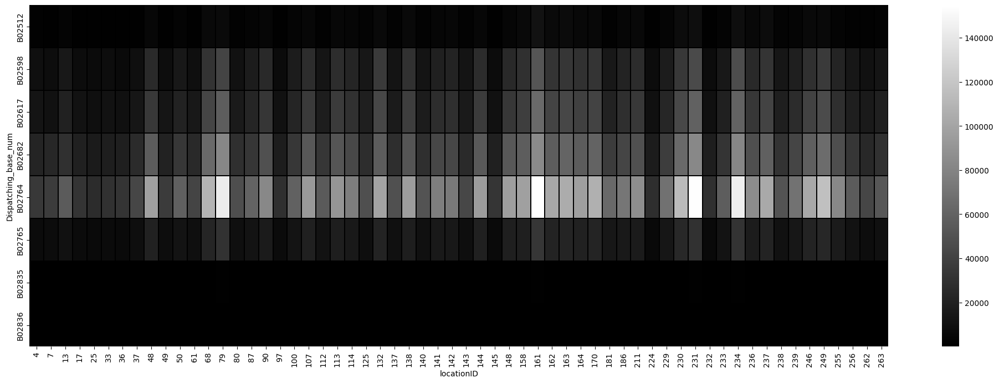

In [32]:
plt.figure(figsize=(25,8))
sns.heatmap(heatmap3,cmap = 'gray',linewidths=0.3,linecolor='black')

<Axes: xlabel='Dayname', ylabel='Dispatching_base_num'>

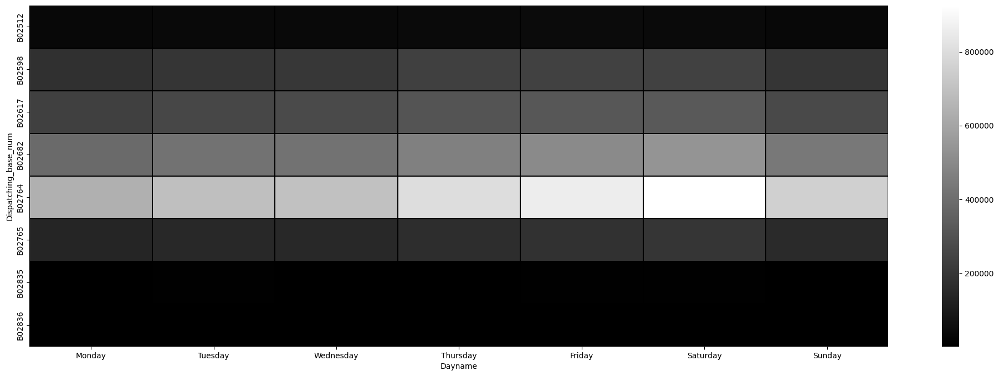

In [33]:
heatmap4 = pd.crosstab(uber['Dispatching_base_num'],uber['Dayname'])
plt.figure(figsize=(25,8))
sns.heatmap(heatmap4,cmap = 'gray',linewidths=0.3,linecolor='black')

<Axes: xlabel='Hours', ylabel='Dispatching_base_num'>

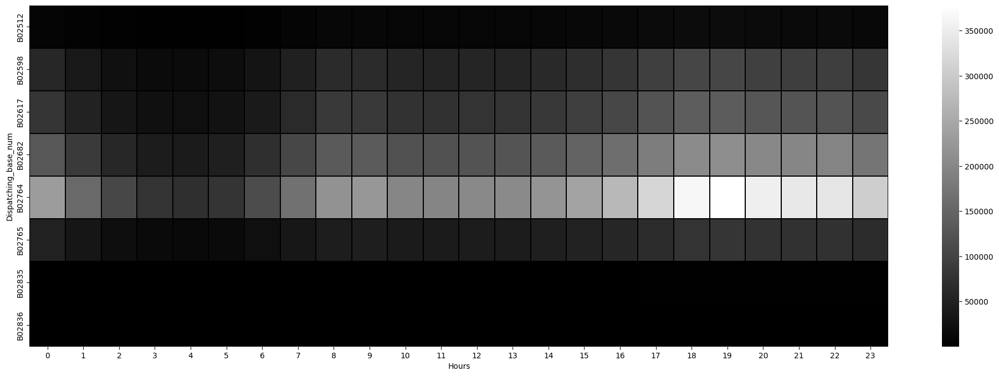

In [34]:
heatmap5 = pd.crosstab(uber['Dispatching_base_num'],uber['Hours'])
plt.figure(figsize=(25,8))
sns.heatmap(heatmap5,cmap = 'gray',linewidths=0.3,linecolor='black')

We are now using another dataset where we can see the info on active vehicles and trips done along with their Base number

In [35]:
uberFOIL = pd.read_csv(r'C:\Users\saysa\Desktop\Py_DS_ML_Bootcamp-master\UberProject\Uber\Datasets\Uber-Jan-Feb-FOIL.csv')

In [36]:
uberFOIL.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,01-01-2015,190,1132
1,B02765,01-01-2015,225,1765
2,B02764,01-01-2015,3427,29421
3,B02682,01-01-2015,945,7679
4,B02617,01-01-2015,1228,9537


In [37]:
uberFOIL.duplicated().sum()

np.int64(0)

In [38]:
summary =uberFOIL.groupby('dispatching_base_number')[['active_vehicles','trips']].sum().reset_index()
#summary = uberFOIL.groupby('dispatching_base_number').agg({'active_vehicles':'sum','trips':'sum'}).reset_index()  - another code for same output
summary

,dispatching_base_number,active_vehicles,trips
0,B02512,13125,93786
1,B02598,58653,540791
2,B02617,79758,725025
3,B02682,71431,662509
4,B02764,217290,1914449
5,B02765,22575,193670


<Axes: xlabel='dispatching_base_number', ylabel='trips'>

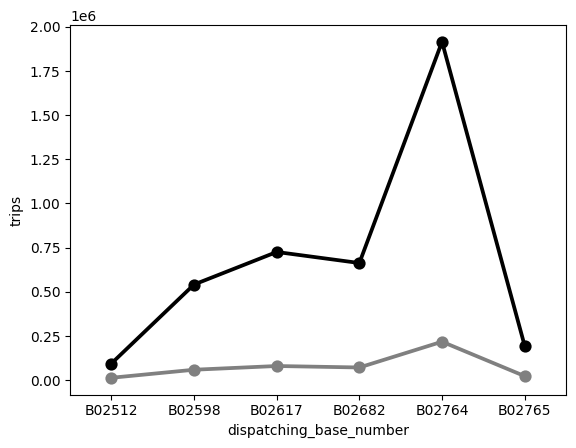

In [39]:
sns.pointplot(x='dispatching_base_number', y='trips', data=summary, color='black')
sns.pointplot(x='dispatching_base_number', y='active_vehicles', data=summary, color='gray')

<Axes: >

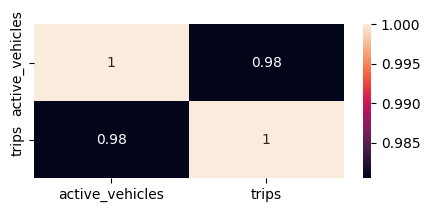

In [40]:
correlation = uberFOIL[['active_vehicles','trips']].corr()
plt.figure(figsize=(5,2))
sns.heatmap(correlation, annot=True )

In [37]:
uberFOIL.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354 entries, 0 to 353
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   dispatching_base_number  354 non-null    object
 1   date                     354 non-null    object
 2   active_vehicles          354 non-null    int64 
 3   trips                    354 non-null    int64 
dtypes: int64(2), object(2)
memory usage: 11.2+ KB


In [38]:
uberFOIL['date'].value_counts()

date
01-01-2015    6
01-02-2015    6
01-03-2015    6
01-04-2015    6
01-05-2015    6
01-06-2015    6
01-07-2015    6
01-08-2015    6
01-09-2015    6
01-10-2015    6
01-11-2015    6
01-12-2015    6
1/13/2015     6
1/14/2015     6
1/15/2015     6
1/16/2015     6
1/17/2015     6
1/18/2015     6
1/19/2015     6
1/20/2015     6
1/21/2015     6
1/22/2015     6
1/23/2015     6
1/24/2015     6
1/25/2015     6
1/26/2015     6
1/27/2015     6
1/28/2015     6
1/29/2015     6
1/30/2015     6
1/31/2015     6
02-01-2015    6
02-02-2015    6
02-03-2015    6
02-04-2015    6
02-05-2015    6
02-06-2015    6
02-07-2015    6
02-08-2015    6
02-09-2015    6
02-10-2015    6
02-11-2015    6
02-12-2015    6
2/13/2015     6
2/14/2015     6
2/15/2015     6
2/16/2015     6
2/17/2015     6
2/18/2015     6
2/19/2015     6
2/20/2015     6
2/21/2015     6
2/22/2015     6
2/23/2015     6
2/24/2015     6
2/25/2015     6
2/26/2015     6
2/27/2015     6
2/28/2015     6
Name: count, dtype: int64

In [39]:
uberFOIL['date']= uberFOIL['date'].str.replace('/','-')

In [41]:
uberFOIL['date'] = pd.to_datetime(uberFOIL['date'])

In [42]:
uberFOIL.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354 entries, 0 to 353
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   dispatching_base_number  354 non-null    object        
 1   date                     354 non-null    datetime64[ns]
 2   active_vehicles          354 non-null    int64         
 3   trips                    354 non-null    int64         
dtypes: datetime64[ns](1), int64(2), object(1)
memory usage: 11.2+ KB


In [43]:
uberFOIL['date'].value_counts()

date
2015-01-01    6
2015-01-02    6
2015-01-03    6
2015-01-04    6
2015-01-05    6
2015-01-06    6
2015-01-07    6
2015-01-08    6
2015-01-09    6
2015-01-10    6
2015-01-11    6
2015-01-12    6
2015-01-13    6
2015-01-14    6
2015-01-15    6
2015-01-16    6
2015-01-17    6
2015-01-18    6
2015-01-19    6
2015-01-20    6
2015-01-21    6
2015-01-22    6
2015-01-23    6
2015-01-24    6
2015-01-25    6
2015-01-26    6
2015-01-27    6
2015-01-28    6
2015-01-29    6
2015-01-30    6
2015-01-31    6
2015-02-01    6
2015-02-02    6
2015-02-03    6
2015-02-04    6
2015-02-05    6
2015-02-06    6
2015-02-07    6
2015-02-08    6
2015-02-09    6
2015-02-10    6
2015-02-11    6
2015-02-12    6
2015-02-13    6
2015-02-14    6
2015-02-15    6
2015-02-16    6
2015-02-17    6
2015-02-18    6
2015-02-19    6
2015-02-20    6
2015-02-21    6
2015-02-22    6
2015-02-23    6
2015-02-24    6
2015-02-25    6
2015-02-26    6
2015-02-27    6
2015-02-28    6
Name: count, dtype: int64

#### IMPORTING PLOTLY AND FOLIUM FOR INTERACTIVE CHARTS AND GEO MAP VISUALISAIONS

In [46]:
import chart_studio.plotly as py
import plotly.graph_objs as go
import plotly.express as px

In [49]:
from plotly.offline import download_plotlyjs , init_notebook_mode , plot , iplot 

In [50]:
init_notebook_mode(connected=True)

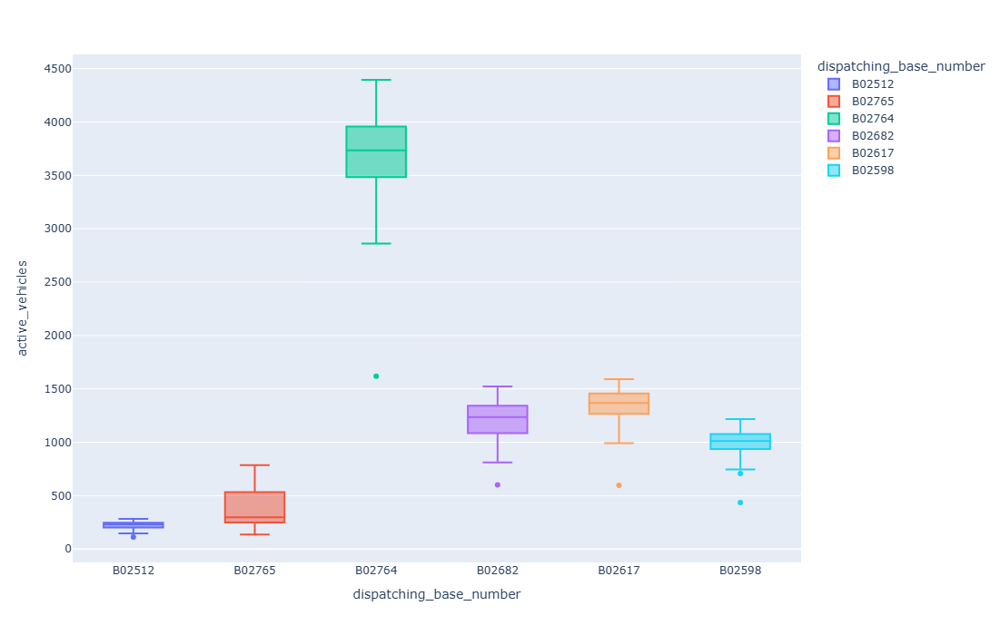

In [47]:
px.box(x='dispatching_base_number',
       y='active_vehicles',data_frame = uberFOIL, orientation ='v',width = 800, height =700 ,color= 'dispatching_base_number')

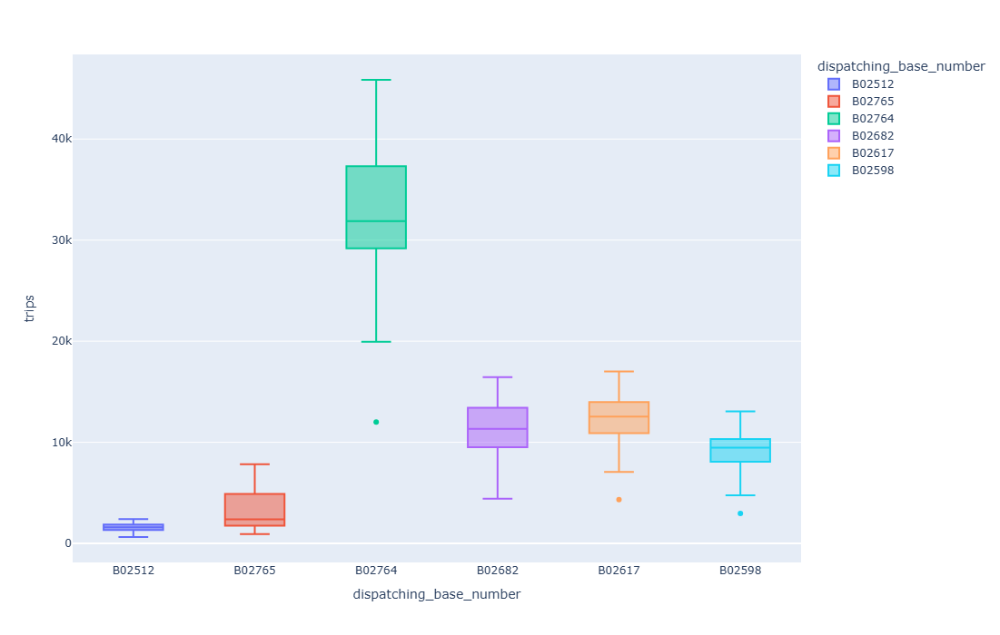

In [48]:
px.box(x='dispatching_base_number',
       y='trips',data_frame = uberFOIL, orientation ='v',width = 800, height =700 ,color= 'dispatching_base_number')

In [51]:
uberFOIL['Month'] = uberFOIL['date'].dt.month
uberFOIL['Monthname'] = uberFOIL['date'].dt.strftime('%b')
uberFOIL['Hours'] = uberFOIL['date'].dt.hour
uberFOIL['Dayname'] = uberFOIL['date'].dt.day_name()
uberFOIL['Daynumber']=uberFOIL['date'].dt.day

In [52]:
uberFOIL.head()

,dispatching_base_number,date,active_vehicles,trips,Month,Monthname,Hours,Dayname,Daynumber
0,B02512,2015-01-01,190,1132,1,Jan,0,Thursday,1
1,B02765,2015-01-01,225,1765,1,Jan,0,Thursday,1
2,B02764,2015-01-01,3427,29421,1,Jan,0,Thursday,1
3,B02682,2015-01-01,945,7679,1,Jan,0,Thursday,1
4,B02617,2015-01-01,1228,9537,1,Jan,0,Thursday,1


In [62]:
uberFOIL['Monthname'] =pd.Categorical(uberFOIL['Monthname'],categories = order_month, ordered =True)
uberFOIL['Dayname'] =pd.Categorical(uberFOIL['Dayname'],categories = order_day, ordered =True)

In [73]:
subdf = uberFOIL.groupby(['Dayname','Monthname'],as_index = False)['trips'].sum()
subdf = subdf[subdf['trips']!=0]

C:\Users\saysa\AppData\Local\Temp\ipykernel_20208\141002868.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



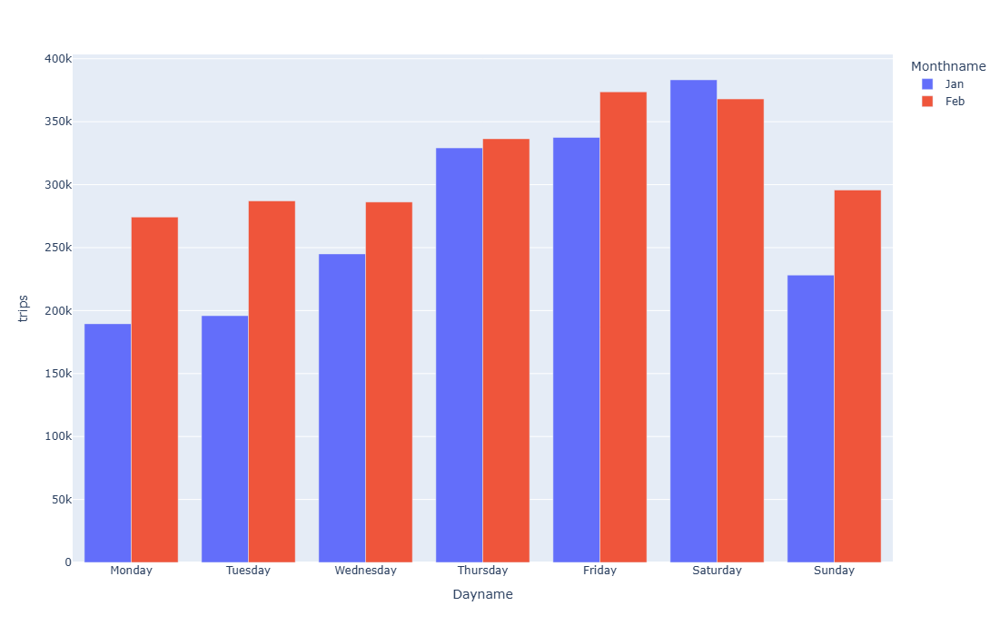

In [75]:
px.bar(data_frame= subdf,x ='Dayname',y='trips',color='Monthname',category_orders = {'Monthname':order_month,'Dayname':order_day}, barmode = 'group', width = 1100 , height = 700)

In [84]:
subdf1 = uberFOIL.groupby(['Daynumber','Monthname'],as_index=False)['trips'].sum()
subdf1.value_counts()

C:\Users\saysa\AppData\Local\Temp\ipykernel_20208\777452211.py:1: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Daynumber  Monthname  trips
1          Jan        56437    1
           Feb        76910    1
           Mar        0        1
           Apr        0        1
           May        0        1
                              ..
31         Feb        0        1
           Mar        0        1
           Apr        0        1
           May        0        1
           Jun        0        1
Name: count, Length: 186, dtype: int64

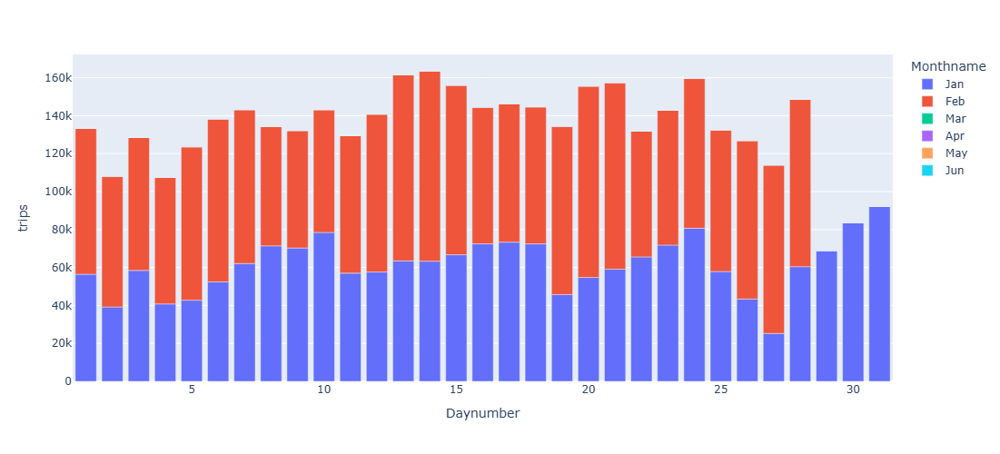

In [88]:
px.bar(data_frame = subdf1, x = 'Daynumber', y= 'trips', color = 'Monthname', category_orders = {'Monthname':order_month}, width = 1000, height =500)

In [46]:
import folium
from folium.plugins import HeatMap

In [47]:
basemap = folium.Map()

In [48]:
files = os.listdir(r'C:\Users\saysa\Desktop\Py_DS_ML_Bootcamp-master\UberProject\Uber\Datasets')

In [49]:
files

['other-American_B01362.csv',
 'other-Carmel_B00256.csv',
 'other-Dial7_B00887.csv',
 'other-Diplo_B01196.csv',
 'other-Federal_02216.csv',
 'other-FHV-services_jan-aug-2015.csv',
 'other-Firstclass_B01536.csv',
 'other-Highclass_B01717.csv',
 'other-Lyft_B02510.csv',
 'other-Prestige_B01338.csv',
 'other-Skyline_B00111.csv',
 'Uber-Jan-Feb-FOIL.csv',
 'uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-janjune-15_sample.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [50]:
files = files[-8:]
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-janjune-15_sample.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [51]:
files.remove('uber-raw-data-janjune-15.csv')

In [52]:
files.remove('uber-raw-data-janjune-15_sample.csv')

In [53]:
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [54]:
main = pd.DataFrame()
pwd = r'C:\Users\saysa\Desktop\Py_DS_ML_Bootcamp-master\UberProject\Uber\Datasets'
for file in files:
    current_pd = pd.read_csv(pwd+'/'+file)
    main = pd.concat([current_pd,main])

main

,Date/Time,Lat,Lon,Base
0,9/1/2014 0:01:00,40.2201,-74.0021,B02512
1,9/1/2014 0:01:00,40.7500,-74.0027,B02512
2,9/1/2014 0:03:00,40.7559,-73.9864,B02512
3,9/1/2014 0:06:00,40.7450,-73.9889,B02512
4,9/1/2014 0:11:00,40.8145,-73.9444,B02512
...,...,...,...,...
564511,4/30/2014 23:22:00,40.7640,-73.9744,B02764
564512,4/30/2014 23:26:00,40.7629,-73.9672,B02764
564513,4/30/2014 23:31:00,40.7443,-73.9889,B02764
564514,4/30/2014 23:32:00,40.6756,-73.9405,B02764


In [55]:
main.duplicated().sum()

np.int64(82581)

In [56]:
main.drop_duplicates(inplace= True)

In [57]:
main.duplicated().sum()

np.int64(0)

In [58]:
main.groupby(['Lat','Lon'],as_index=False).size()

,Lat,Lon,size
0,39.6569,-74.2258,1
1,39.6686,-74.1607,1
2,39.7214,-74.2446,1
3,39.8416,-74.1512,1
4,39.9055,-74.0791,1
...,...,...,...
574553,41.3730,-72.9237,1
574554,41.3737,-73.7988,1
574555,41.5016,-72.8987,1
574556,41.5276,-72.7734,1


In [59]:
HeatMap(main.groupby(['Lat','Lon'],as_index=False).size(),min_opacity =0.1).add_to(basemap)

In [60]:
basemap

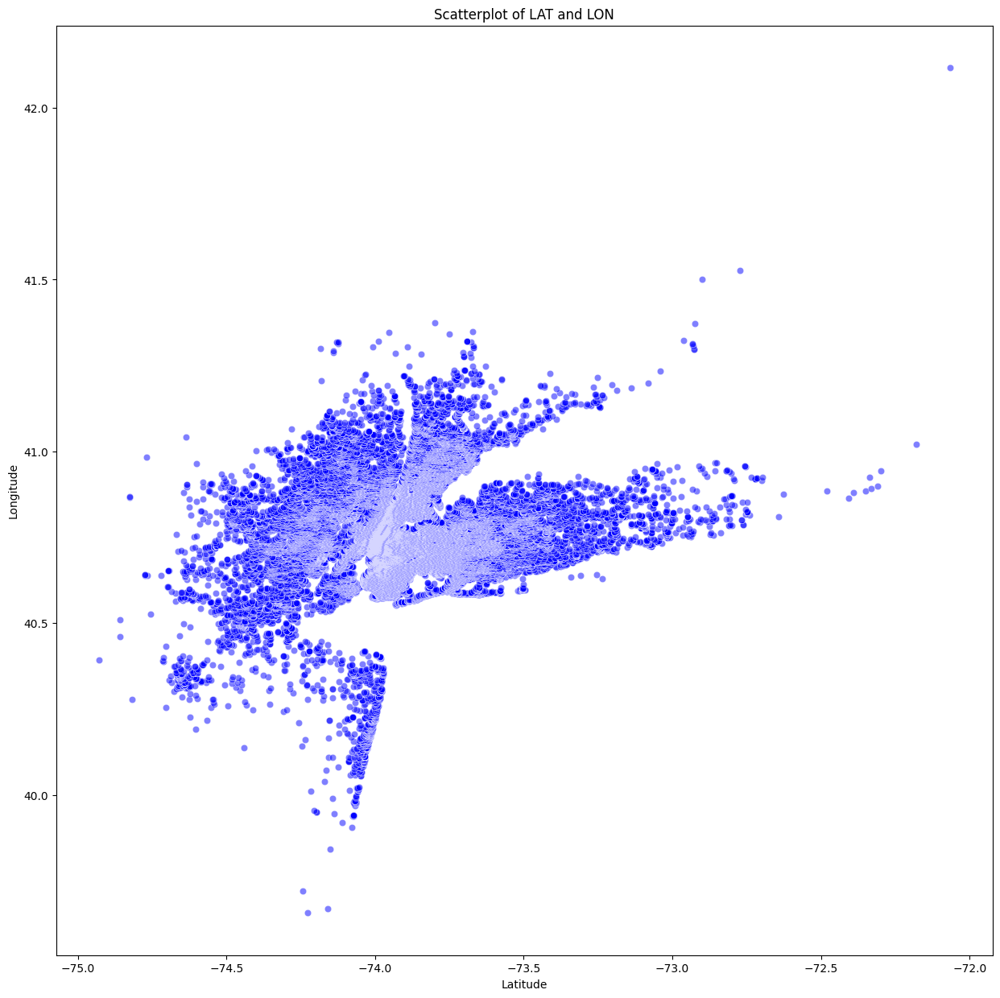

In [61]:
plt.figure(figsize=(15,15))
sns.scatterplot(x='Lon',y='Lat',data= main.groupby(['Lat','Lon'],as_index=False).size(),alpha = 0.5,color='blue')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Scatterplot of LAT and LON')
plt.show()